## Defining a basic transport network
In this notebook, we show how to setup a  simple transport network. 

We take the following steps:

1. [Imports](#1.-Imports)
2. [Create graph](#2.-Create-graph)
3. [Create (slightly) more complicated graph](#3.-Create-(slightly)-more-complicated-graph)

### 1. Imports
We start with importing required libraries

In [16]:
# package(s) used for creating and geo-locating the graph
import networkx as nx  

# package(s) related to the simulation (creating the vessel, running the simulation)
import opentnsim
from opentnsim import graph as graph_module

# package(s) needed for plotting
import shapely.geometry
from shapely.geometry import Point, LineString
from shapely.geometry.base import BaseGeometry
import pyproj


# plot libraries
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

print('This notebook is executed with OpenTNSim version {}'.format(opentnsim.__version__))

This notebook is executed with OpenTNSim version 1.1.2


In [17]:
# create a basic plotting method (plotly based, with labels properly positioned)
def plot_graph(FG):
    
    def compute_distance(WGS84, origin: shapely.Geometry, destination: shapely.Geometry):
        """Determine the distance based on great circle path from origin to destination."""
        orig = shapely.geometry.shape(origin)
        dest = shapely.geometry.shape(destination)
        _, _, distance = WGS84.inv(orig.x, orig.y, dest.x, dest.y)
    
        return distance
        
    # Extract node positions
    pos = {node: (FG.nodes[node]['geometry'].x, FG.nodes[node]['geometry'].y) for node in FG.nodes}
    
    # Create Plotly figure
    fig = make_subplots(rows=1, cols=1)
    
    # Add edges to the figure
    for edge in FG.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        fig.add_trace(go.Scatter(x=[x0, x1], y=[y0, y1], mode='lines', line=dict(width=4, color='blue')))
    
    
    # Add nodes to the figure
    for node in FG.nodes():
        x, y = pos[node]
        fig.add_trace(go.Scatter(x=[x], y=[y], mode='markers+text', text=['<b> {} </b>'.format(node)], textposition='middle center',
                                 marker=dict(size=20, color='red')))
    
    # Add labels to the figure
    for index, edge in enumerate(FG.edges):
        # Add label '100 km' over the trace with the same y position as the node labels
        mid_x = (pos[edge[0]][0] + pos[edge[1]][0]) / 2
        
        # Use the same y position as the nodes
        mid_y =  pos[edge[0]][1]  

        # Calculate distance
        distance = compute_distance(pyproj.Geod(ellps="WGS84"), FG.nodes[edge[0]]['geometry'], FG.nodes[edge[1]]['geometry'])
        
        # add edge length
        fig.add_trace(go.Scatter(x=[mid_x], y=[mid_y], mode='text', text=['<b>{:.1f} km</b><br>'.format(distance/1000)], 
                                 textposition='top center'))
        # add edge depth
        fig.add_trace(go.Scatter(x=[mid_x], y=[mid_y], mode='text', text=['<br><b> {} </b>'.format(FG.edges[edge]['Info']['GeneralDepth'])],
                                 textposition='bottom center'))
    
    # Update layout
    fig.update_layout(
        {
            'plot_bgcolor':  'rgba(0, 0, 0, 0)',
            'paper_bgcolor': 'rgba(0, 0, 0, 0)',
        },
        margin={"t": 0, "b": 0, "l": 0, "r": 0},
        height=80,
        showlegend=False)
    
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)

    return fig

### 2. Create graph
OpenTNSim works with mix-in classes to allow for flexibility in defining nodes. 

A graph contains *nodes* (blue dots in plot below) and *edges* (red arrows in plot below).

In [18]:
# Create a one edge graph (distance 100 km)
node_A = graph_module.Node(name='0', geometry=Point(0, 0))
node_B = graph_module.Node(name='1', geometry=Point(1 * 0.8983152841195216, 0))

nodes  = [node_A, node_B]
edges  = [(node_A, node_B)]
depths = {"GeneralDepth": [10.0]}

FG = graph_module.DiGraph(edges=edges, edges_info=depths).graph

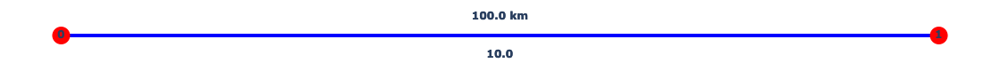

In [19]:
plot_graph(FG)

In [20]:
FG.__dict__

{'graph': {},
 '_node': {'0': {'geometry': <POINT (0 0)>},
  '1': {'geometry': <POINT (0.898 0)>}},
 '_adj': {'0': {'1': {'weight': 1,
    'geometry': <LINESTRING (0 0, 0.898 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}},
  '1': {'0': {'weight': 1,
    'geometry': <LINESTRING (0.898 0, 0 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}}},
 '_succ': {'0': {'1': {'weight': 1,
    'geometry': <LINESTRING (0 0, 0.898 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}},
  '1': {'0': {'weight': 1,
    'geometry': <LINESTRING (0.898 0, 0 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}}},
 '_pred': {'0': {'1': {'weight': 1,
    'geometry': <LINESTRING (0.898 0, 0 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}},
  '1': {'0': {'weight': 1,
    'geometry': <LINESTRING (0 0, 0.898 0)>,
    'length': 100000.00000000001,
    'Info': {'GeneralDepth': 10.0}}}},
 'nodes

In [21]:
path = nx.dijkstra_path(FG, '0', '1')
path

['0', '1']

### 3. Create (slightly) more complicated graph

In [22]:
node_A = graph_module.Node(name='0', geometry=Point(0, 0))
node_B = graph_module.Node(name='1', geometry=Point(1 * 0.8983152841195216, 0))
node_C = graph_module.Node(name='2', geometry=Point(2 * 0.8983152841195216, 0))
node_D = graph_module.Node(name='3', geometry=Point(3 * 0.8983152841195216, 0))

nodes  = [node_A, node_B, node_C, node_D]
edges  = [(node_A, node_B), (node_B, node_C), (node_C, node_D)]
depths = {"GeneralDepth": [10.0, 6.0, 10.0]}

FG = graph_module.DiGraph(edges=edges, edges_info=depths).graph

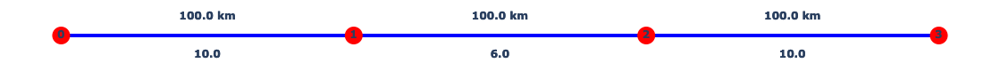

In [23]:
plot_graph(FG)

In [24]:
path = nx.dijkstra_path(FG, '0', '3')
path

['0', '1', '2', '3']

### 4. The FIS graph

In [25]:
import opentnsim.fis

# FG = opentnsim.fis.load_network(version="0.2")
FG = opentnsim.fis.load_network(version="0.3")

In [26]:
pos = {node: (FG.nodes[node]['geometry'].x, FG.nodes[node]['geometry'].y) for node in FG.nodes}

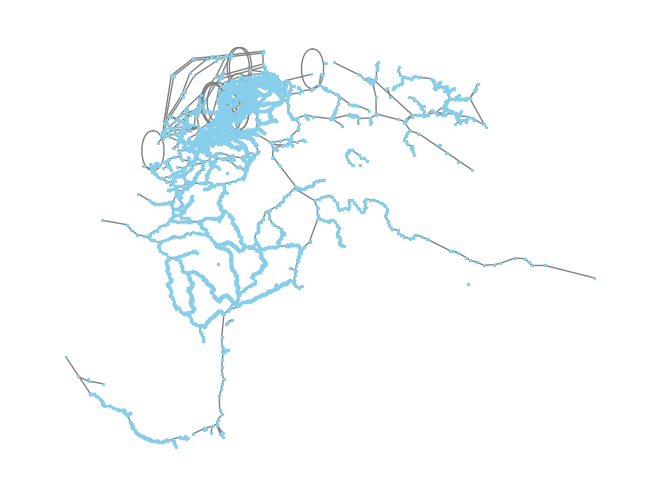

In [27]:
nx.draw(FG, pos, with_labels=False, node_size=2, node_color="skyblue", font_size=10, font_color="black", font_weight="bold", edge_color="gray")
plt.show()

In [29]:
import folium

# Plot the network and highlight the Volkerak locks
m = folium.Map(location=[51.7, 4.4], zoom_start = 7, tiles="cartodbpositron")

for edge in FG.edges(data = True):
    points_x = list(edge[2]["geometry"].coords.xy[0])
    points_y = list(edge[2]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
    folium.PolyLine(line, weight = 2, popup = edge[2]["StartJunctionId"]).add_to(m)
     

m

In [30]:
path = nx.dijkstra_path(FG, '18008360', '8867341')
path

['18008360', '8864615', '8864185', '8866260', '8864288', '8864014', '8867341']